In [102]:
using FFTW, Plots, LinearAlgebra, SparseArrays, Printf, Plots, CSV, DataFrames, SpecialFunctions
import Base: diff

# Trogdon Code
rnd = xx -> map(x -> round(x, digits = 5),xx)
mfftshift = x -> circshift(fftshift(x), isodd(length(x)) ? 1 : 0)
mfft = x -> fftshift(fft(fftshift(x),1)) # fft(x,1) is used so that
# when we operate on matrices below, the behavior is as desired.
mifft = x -> mfftshift(ifft(mfftshift(x),1))
mgrid = (n,L) -> -L .+ 2*L*(0:n-1)/n # array from -L to L leaving out L

F = c -> -1 .* mfft(mifft(D*c) .* integrate(c) .+ mifft(c).^2)

#299 (generic function with 1 method)

In [103]:
function CG(A,b,eps::Float64)
   x = 0.0*b; r = b; p = r; n = 0;
   while norm(r) > eps
        q = A(p)
        a = (r'*r)/(p'*q)
        x += a*p
        r_old = r
        r += - a*q
        b = (r'*r)/(r_old'*r_old)
        p = r + b*p 
        n += 1
    end
    x
end

CG (generic function with 1 method)

In [104]:
ϵ = 10^(-1.5)
function rk4(a, t, dt) 
    f1 = exp(ϵ^2 * D.^3 * t) * F(exp(-ϵ^2 * D.^3 * t) * a)
    f2 = exp(ϵ^2 * D.^3 * (t + dt/2)) * F(exp(-ϵ^2 * D.^3 * (t+dt/2)) * (a+(dt/2)*f1))
    f3 = exp(ϵ^2 * D.^3 * (t + dt/2)) * F(exp(-ϵ^2 * D.^3 * (t+dt/2)) * (a+(dt/2)*f2))
    f4 = exp(ϵ^2 * D.^3 * (t + dt)) * F(exp(-ϵ^2 * D.^3 * (t + dt)) * (a+dt*f3))
    a = a + (dt/6)*(f1+2*f2+2*f3+f4)
    return a
end

rk4 (generic function with 1 method)

In [105]:
struct trig_interp
    L::Float64
    c::Vector{Complex{Float64}}
end

function (tr::trig_interp)(x) # just sums the Fourier series!
    m = length(tr.c)
    mm = convert(Int64,floor( m/2 ))
    σ = isodd(m) ? 1im*pi/m : 0. # if n is odd we need to rotate coefs
    ex = exp.(-1im*pi*mm*x/tr.L + mm*σ)
    ex1 = exp.(1im*pi*x/tr.L-σ)
    sum = tr.c[1]*ex
    for i = 2:length(tr.c)
        ex  =  ex.*ex1
        sum += tr.c[i]*ex
    end
    return sum/m
end 

In [106]:
# input: vector c of Fourier coefficients of a function
# variables defined outside of function: L,c_,n,X,m,iD
# output: vector q of function values of the antiderivative of the function
function integrate(c)
    ind = findfirst(n .== 0)
    S = iD*c
    q = c[ind]/m .* (X .+ L) + mifft(S)
    q = q .- q[1] .+ c_
    return q
end

integrate (generic function with 1 method)

## IC used in paper

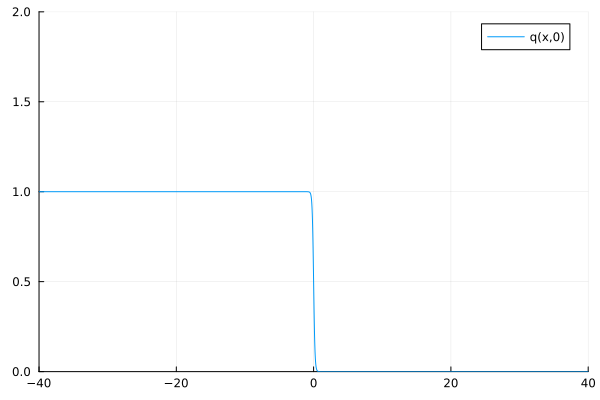

In [86]:
L = 40
m = 2^12
X = mgrid(m,L)

if isodd(m)
    n = (1-length(X))./2 .+ (0:(length(X)-1))
else
    n = -1 .* length(X) ./ 2 .+ (0:(length(X)-1))
end
D = (pi/L) * Diagonal(1im.*n)
ind = findfirst(n .== 0)
iD = copy(D)
iD[ind,ind] = 1.0
iD = inv(iD)
iD[ind,ind] = 0.0

# initial condition
func = x -> (1 .+ exp.(10*x)).^(-1)
f = func(X)
c_ = f[1]
plot(X,f, xaxis = [-L,L], yaxis = [0,2], label = "q(x,0)")
#savefig("fig6")

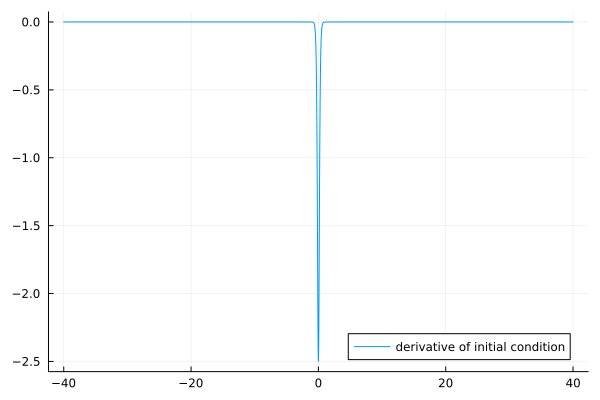

In [87]:
# derivative of initial condition
f_prime = -(10 * exp.(10 .* X)) ./ (1 .+ exp.(10 .* X)).^2
plot(X,f_prime, label = "derivative of initial condition")

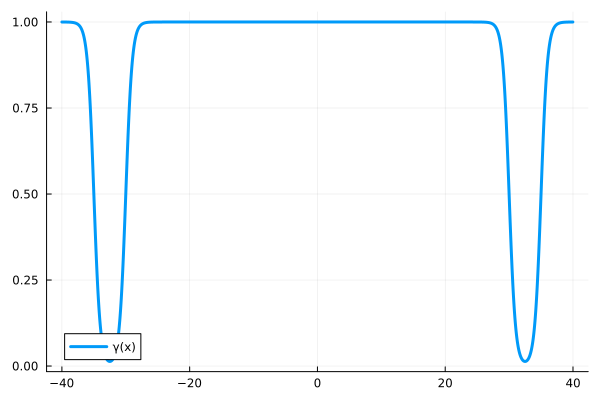

In [88]:
#damping
ℓ1 = -L + (L/2) - 10
ℓ2 = L - 5
σ1 = x -> (1 .- (0.5.*(tanh.((x.-ℓ1)) .+ 1) + 0.5.*(tanh.((-x.-ℓ2)) .+ 1)))
σ = x -> σ1(x) .+ σ1(-x)
γ = x -> 1 .- σ(-x)

plot(X,γ(X),label = "γ(x)", linewidth = 3)
#plot!(X,σ(X),label = "σ(x)")
#savefig("gamma")

In [89]:
c = mfft(f_prime)
dt = 0.001
T = 25
t = 0.0
t += dt
steps = convert(Int64,ceil(T/dt))
ϵ = 10^(-1.5)

y_low = 0
y_up = 2
x_low = -L
x_up = L

@time begin
    
for i = 1:steps+1
        
    a = rk4(c,0,dt)
    c = exp(-ϵ^2 * D.^3 * dt) * a    
    t += dt
    
    if isinteger(i / 1000)
        func_vals = mifft(c) .* γ(X)
        c = mfft(func_vals)
    end
end
    
end

 36.177473 seconds (22.13 M allocations: 233.339 GiB, 5.79% gc time)


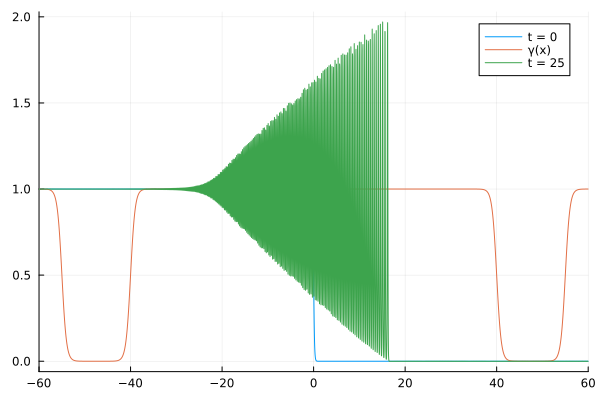

In [81]:
plot(X, f, xaxis = [x_low,x_up], label = "t = 0")
plot!(X,γ(X),label = "γ(x)")
plot!(X, integrate(c) |> real, xaxis = [x_low,x_up], label = "t = 25")

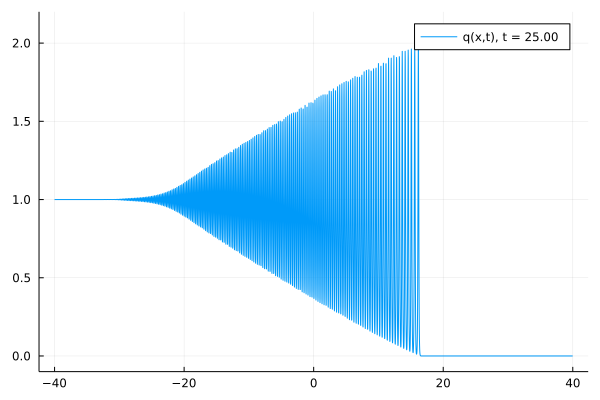

284.795716 seconds (33.99 M allocations: 234.803 GiB, 6.67% gc time)


┌ Info: Saved animation to 
│   fn = C:\Users\annie\Dropbox\ArtificialBoundaryConditions\damped_riemann.gif
└ @ Plots C:\Users\annie\.julia\packages\Plots\Ra8fG\src\animation.jl:126


Plots.AnimatedGif("C:\\Users\\annie\\Dropbox\\ArtificialBoundaryConditions\\damped_riemann.gif")
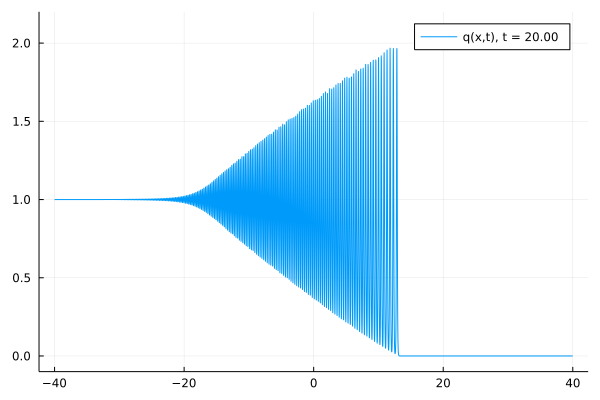

In [20]:
# make gif
c = mfft(f_prime)
dt = 0.001
T = 25
t = 0.0
anim = Animation()
#plot(X, f, yaxis = [-0.1,2.1], label = @sprintf("q(x,t), t = %1.2f",t)) |> IJulia.display
#frame(anim)
t += dt
fr = 100 #frames/unit time
steps = convert(Int64,ceil(T/dt))
tb = convert(Int64,ceil(steps/(fr*T)))
ϵ = 10^(-1.5)

y_low = 0
y_up = 2
x_low = -L
x_up = L

@time begin
    
for i = 1:steps+1
        
    a = rk4(c,0,dt)
    c = exp(-ϵ^2 * D.^3 * dt) * a    
    t += dt
    
    if isinteger(i / 1000)
        func_vals = mifft(c) .* γ(X)
        c = mfft(func_vals)
    end
        
    if mod(i-1,tb) ≈ 0.0 && t > 20
        U = integrate(c) |> real
        IJulia.clear_output(true)    
        plot(X, U |> real, yaxis = [-0.1,2.2], label = @sprintf("q(x,t), t = %1.2f",t)) |> IJulia.display
        frame(anim)
    end
end
    
end

gif(anim,"damped_riemann.gif")

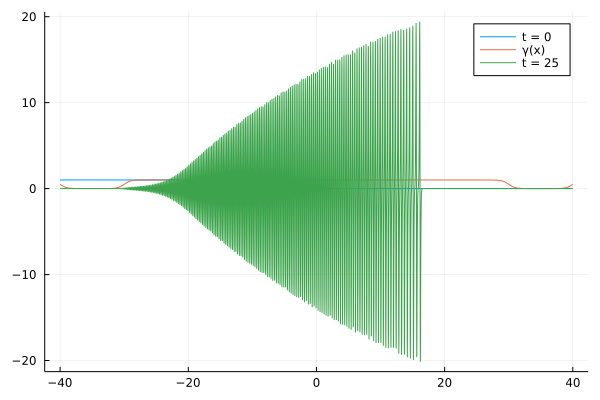

In [11]:
plot(X, f, xaxis = [x_low,x_up], label = "t = 0")
plot!(X,γ(X),label = "γ(x)")
plot!(X, mifft(c) |> real, xaxis = [x_low,x_up], label = "t = 25")

## Plotting on a new grid

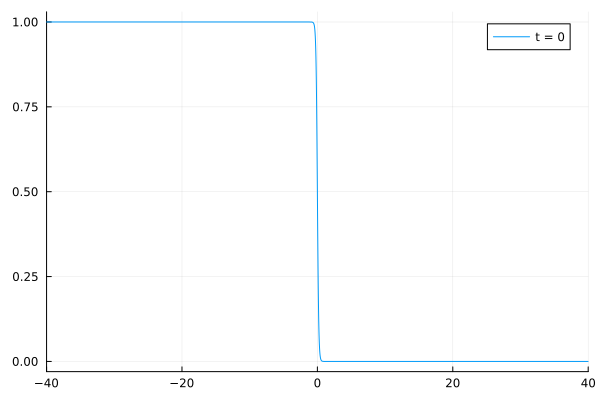

In [90]:
plot(X, f, xaxis = [-40,40], label = "t = 0")

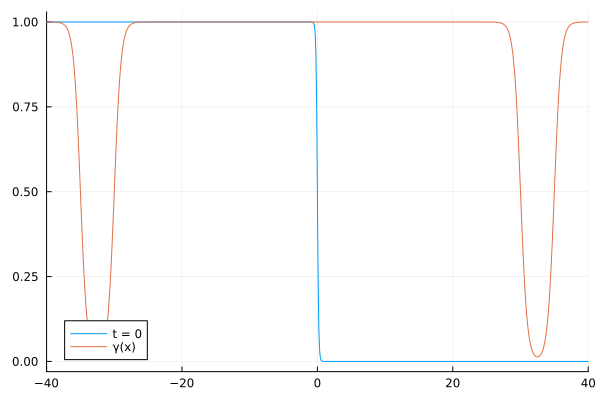

In [91]:
plot!(X,γ(X), label = "γ(x)")

In [92]:
# defining new grid so that all plots have same resolution
m = 2^15
X = mgrid(m,L)

if isodd(m)
    n = (1-length(X))./2 .+ (0:(length(X)-1))
else
    n = -1 .* length(X) ./ 2 .+ (0:(length(X)-1))
end
D = (pi/L) * Diagonal(1im.*n)
ind = findfirst(n .== 0)
iD = copy(D)
iD[ind,ind] = 1.0
iD = inv(iD)
iD[ind,ind] = 0.0

0.0

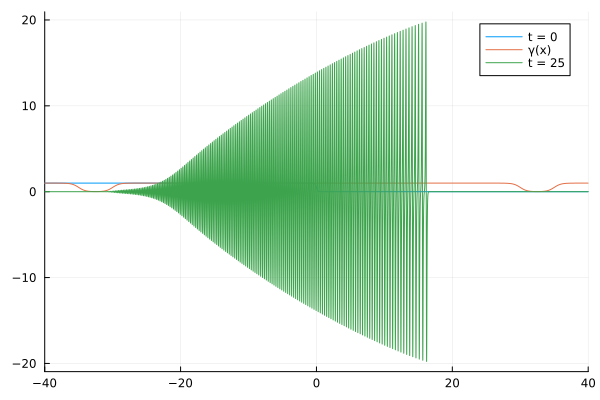

In [93]:
fm = trig_interp(L,c)
new_df = map(fm,X)
c_new = mfft(new_df)
plot!(X, mifft(c_new) |> real, xaxis = [-40,40], label = "t = 25")

In [94]:
savefig("shockderiv.pdf")

"/Users/annieliu/Library/CloudStorage/Dropbox/Mac/Documents/Artificial Boundary Conditions/shockderiv.pdf"

## Grava and Klein IC

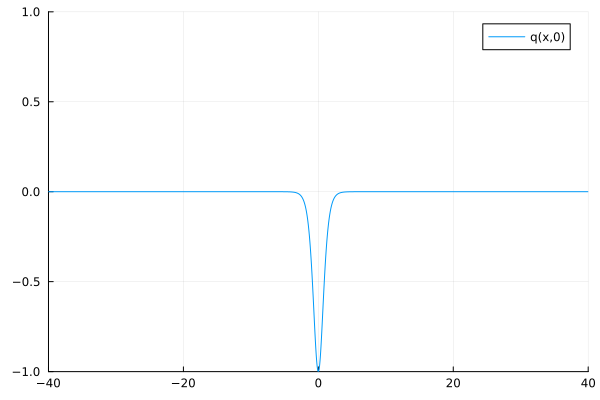

In [107]:
L = 40
m = 2^12
X = mgrid(m,L)

if isodd(m)
    n = (1-length(X))./2 .+ (0:(length(X)-1))
else
    n = -1 .* length(X) ./ 2 .+ (0:(length(X)-1))
end
D = (pi/L) * Diagonal(1im.*n)
ind = findfirst(n .== 0)
iD = copy(D)
iD[ind,ind] = 1.0
iD = inv(iD)
iD[ind,ind] = 0.0

# initial condition
func = x -> -1 ./ ((cosh.(x)).^2)
f = func(X)
c_ = f[1]
plot(X,f, xaxis = [-L,L], yaxis = [-1,1], label = "q(x,0)")
#savefig("fig6")

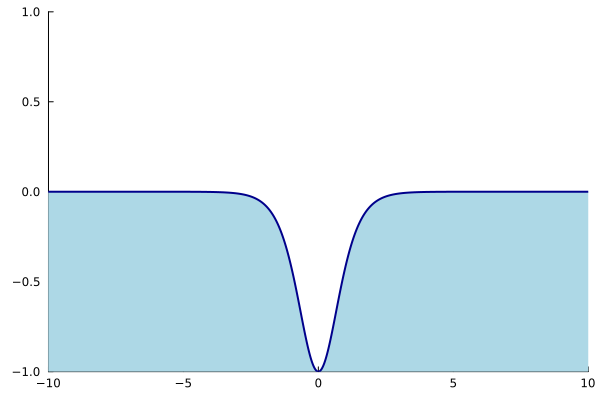

In [108]:
plot(X, f, xaxis = [-10,10], yaxis = [-1,1], label = false, linewidth = 2, linecolor = :darkblue, grid = false, fill = (-1,:lightblue))
#savefig("gravakleinIC.pdf")

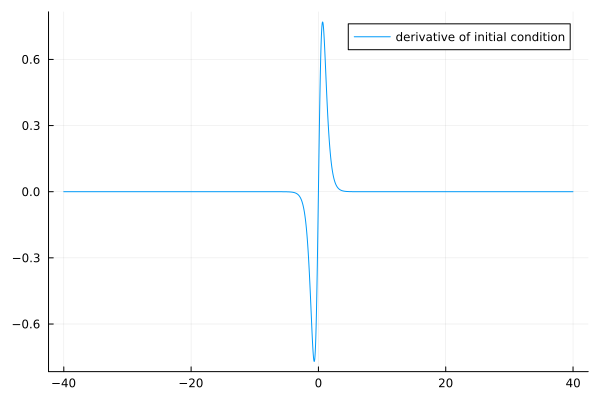

In [109]:
# derivative of initial condition
f_prime = 2 .* tanh.(X) .* (sech.(X)).^2
plot(X,f_prime, label = "derivative of initial condition")

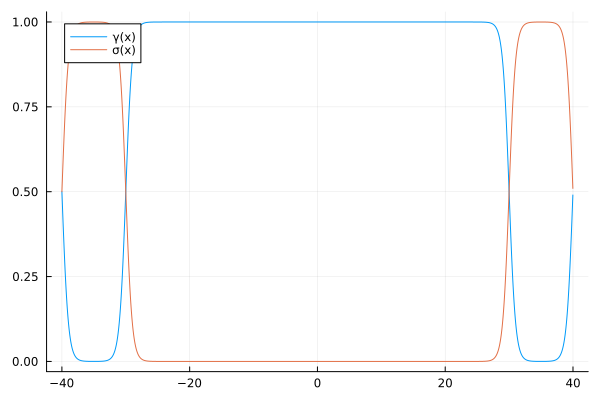

In [110]:
#damping
ℓ1 = -L + (L/2) - 10
ℓ2 = L - 5
σ1 = x -> (1 .- (0.5.*(tanh.((x.-ℓ1)) .+ 1) + 0.5.*(tanh.((-x.-ℓ2)) .+ 1)))
# make symmetric:
σ = x -> σ1(x) .+ σ1(-x)
γ = x -> 1 .- σ(-x) # should gamma be skinnier than sigma?

Σ = Diagonal(σ(X))
A = x -> x + (dt/2)*D*mfft(Σ*mifft(D*x))
B = x -> x - (dt/2)*D*mfft(Σ*mifft(D*x))
plot(X,γ(X),label = "γ(x)")
plot!(X,σ(X),label = "σ(x)")

  7.147502 seconds (4.49 M allocations: 46.670 GiB, 5.87% gc time, 0.83% compilation time)


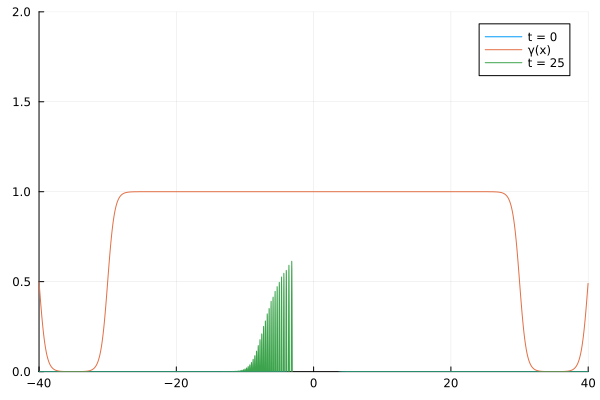

In [111]:
c = mfft(f_prime)
dt = 0.001
T = 5
t = 0.0
fr = 100 #frames/unit time
steps = convert(Int64,ceil(T/dt))
tb = convert(Int64,ceil(steps/(fr*T)))
ϵ = 10^(-1.5)

y_low = 0
y_up = 2
x_low = -L
x_up = L

@time begin
    
for i = 1:steps        
    a = rk4(c,0,dt)
    c = exp(-ϵ^2 * D.^3 * dt) * a    
    t += dt
    
    if isinteger(i / 1000)
        func_vals = mifft(c) .* γ(X)
        c = mfft(func_vals)
    end
end
    
end

plot(X, f, xaxis = [x_low,x_up], yaxis = [y_low,y_up], label = "t = 0")
plot!(X,γ(X),label = "γ(x)")
plot!(X, integrate(c) |> real, label = "t = 25")

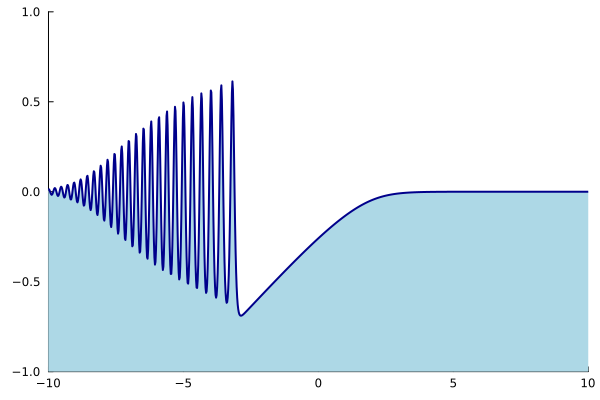

In [112]:
plot(X, integrate(c) |> real, xaxis = [-10,10], yaxis = [-1,1], label = false, linewidth = 2, linecolor = :darkblue, grid = false, fill = (-1,:lightblue))

In [113]:
savefig("gravaklein.pdf")

"/Users/annieliu/Library/CloudStorage/Dropbox/Mac/Documents/Artificial Boundary Conditions/gravaklein.pdf"

## Soliton on top of shelf

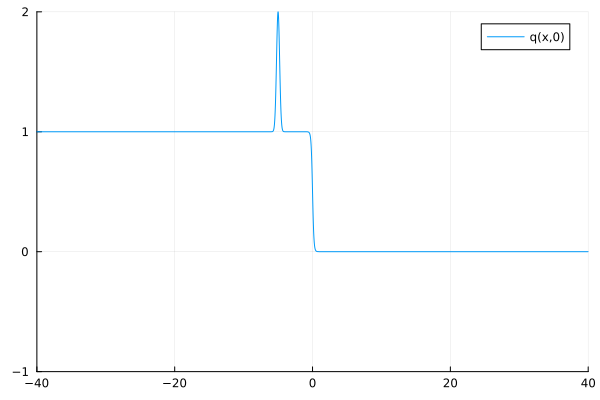

In [114]:
L = 40
m = 2^12
X = mgrid(m,L)

if isodd(m)
    n = (1-length(X))./2 .+ (0:(length(X)-1))
else
    n = -1 .* length(X) ./ 2 .+ (0:(length(X)-1))
end
D = (pi/L) * Diagonal(1im.*n)
ind = findfirst(n .== 0)
iD = copy(D)
iD[ind,ind] = 1.0
iD = inv(iD)
iD[ind,ind] = 0.0

# initial condition
func = x -> -1 ./ (1 .+ exp.(-10*x)) .+ 1 .+ exp.(-10*(x .+ 5).^2)
f = func(X)
c_ = f[1]
plot(X,f, xaxis = [-L,L], yaxis = [-1,2], label = "q(x,0)")
#savefig("fig6")

In [116]:
plot(X, f, xaxis = [-10,10], yaxis = [-0.5,3.5], label = false, linewidth = 2, linecolor = :darkblue, grid = false, fill = (-1,:lightblue))
savefig("solitonshelfIC.pdf")

"/Users/annieliu/Library/CloudStorage/Dropbox/Mac/Documents/Artificial Boundary Conditions/solitonshelfIC.pdf"

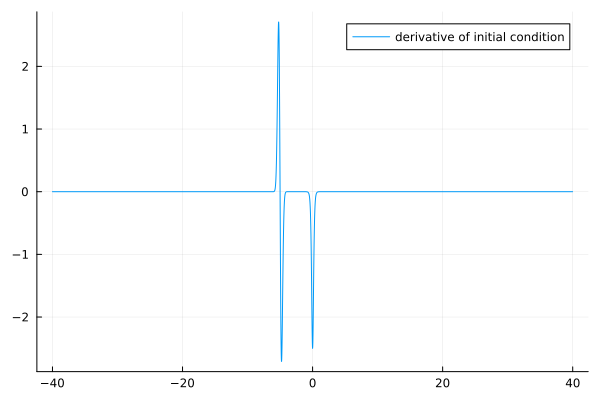

In [117]:
# derivative of initial condition
f_prime = -20 * exp.(-10 * (X .+ 5).^2) .* (X .+ 5) .- (10 * exp.(-10 * X)) ./ ((1 .+ exp.(-10 * X)).^2)
plot(X,f_prime, label = "derivative of initial condition")

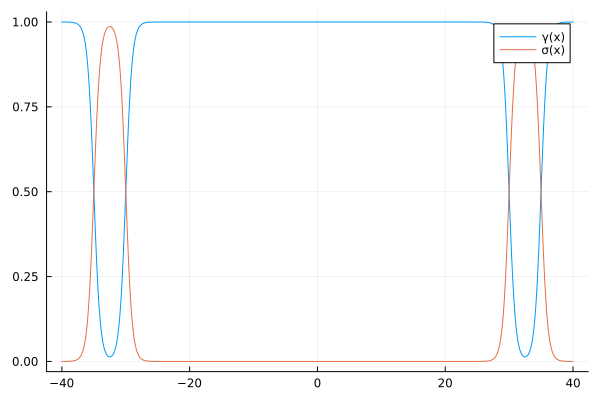

In [119]:
#damping
ℓ1 = -L + (L/2) - 10
ℓ2 = L - 5
σ1 = x -> (1 .- (0.5.*(tanh.((x.-ℓ1)) .+ 1) + 0.5.*(tanh.((-x.-ℓ2)) .+ 1)))
# make symmetric:
σ = x -> σ1(x) .+ σ1(-x)
γ = x -> 1 .- σ(-x) # should gamma be skinnier than sigma?

Σ = Diagonal(σ(X))
A = x -> x + (dt/2)*D*mfft(Σ*mifft(D*x))
B = x -> x - (dt/2)*D*mfft(Σ*mifft(D*x))
plot(X,γ(X),label = "γ(x)")
plot!(X,σ(X),label = "σ(x)")

  7.310933 seconds (4.42 M allocations: 46.666 GiB, 5.88% gc time)


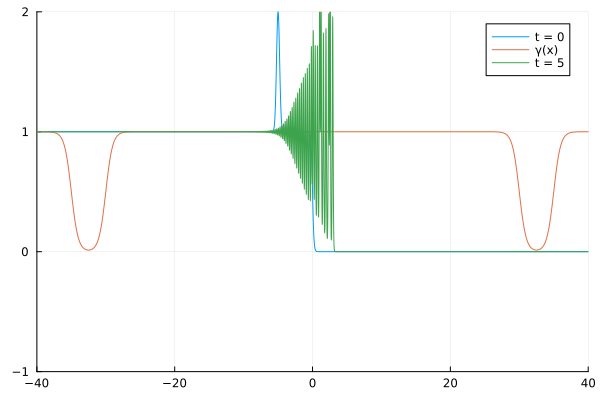

In [120]:
c = mfft(f_prime)
dt = 0.001
T = 5
t = 0.0
fr = 100 #frames/unit time
steps = convert(Int64,ceil(T/dt))
tb = convert(Int64,ceil(steps/(fr*T)))
ϵ = 10^(-1.5)

y_low = -1
y_up = 2
x_low = -L
x_up = L

@time begin
    
for i = 1:steps      
    a = rk4(c,0,dt)
    c = exp(-ϵ^2 * D.^3 * dt) * a 
    t += dt
    
    if isinteger(i / 1000)
        func_vals = mifft(c) .* γ(X)
        c = mfft(func_vals)
    end
end
    
end

plot(X, f, xaxis = [x_low,x_up], yaxis = [y_low,y_up], label = "t = 0")
plot!(X,γ(X),label = "γ(x)")
plot!(X, integrate(c) |> real, label = "t = 5")

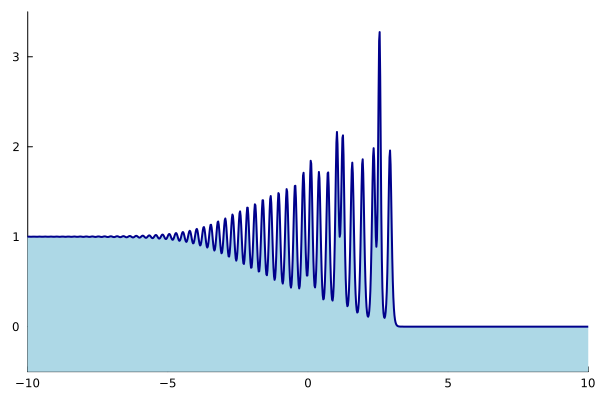

In [121]:
plot(X, integrate(c) |> real, xaxis = [-10,10], yaxis = [-0.5,3.5], label = false, linewidth = 2, linecolor = :darkblue, grid = false, fill = (-1,:lightblue))

In [122]:
savefig("solitonshelf.pdf")

"/Users/annieliu/Library/CloudStorage/Dropbox/Mac/Documents/Artificial Boundary Conditions/solitonshelf.pdf"